## EDA

## Importing all Necessary Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


## Load the Dataset

In [2]:
data=pd.read_csv('/content/sample_data/temperature_data (1).csv')

In [ ]:
data

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,pm,stator_yoke,stator_tooth,stator_winding,profile_id
0,-0.752143,-1.118446,0.327935,-1.297858,-1.222428,-0.250182,1.029572,-0.245860,-2.522071,-1.831422,-2.066143,-2.018033,4
1,-0.771263,-1.117021,0.329665,-1.297686,-1.222429,-0.249133,1.029509,-0.245832,-2.522418,-1.830969,-2.064859,-2.017631,4
2,-0.782892,-1.116681,0.332771,-1.301822,-1.222428,-0.249431,1.029448,-0.245818,-2.522673,-1.830400,-2.064073,-2.017343,4
3,-0.780935,-1.116764,0.333700,-1.301852,-1.222430,-0.248636,1.032845,-0.246955,-2.521639,-1.830333,-2.063137,-2.017632,4
4,-0.774043,-1.116775,0.335206,-1.303118,-1.222429,-0.248701,1.031807,-0.246610,-2.521900,-1.830498,-2.062795,-2.018145,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
998065,-0.047497,0.341638,0.331475,-1.246114,-1.222428,-0.255640,1.029142,-0.245723,0.429853,1.018568,0.836084,0.494725,72
998066,-0.048839,0.320022,0.331701,-1.250655,-1.222437,-0.255640,1.029148,-0.245736,0.429751,1.013416,0.834438,0.494279,72
998067,-0.042350,0.307415,0.330946,-1.246852,-1.222430,-0.255640,1.029191,-0.245701,0.429439,1.002906,0.833936,0.492666,72
998068,-0.039433,0.302082,0.330987,-1.249505,-1.222432,-0.255640,1.029147,-0.245727,0.429558,0.999157,0.830504,0.490581,72


## Basic Data Exploration

In [ ]:
print('Data Info:')
data.info()

Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998070 entries, 0 to 998069
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   ambient         998070 non-null  float64
 1   coolant         998070 non-null  float64
 2   u_d             998070 non-null  float64
 3   u_q             998070 non-null  float64
 4   motor_speed     998070 non-null  float64
 5   torque          998070 non-null  float64
 6   i_d             998070 non-null  float64
 7   i_q             998070 non-null  float64
 8   pm              998070 non-null  float64
 9   stator_yoke     998070 non-null  float64
 10  stator_tooth    998070 non-null  float64
 11  stator_winding  998070 non-null  float64
 12  profile_id      998070 non-null  int64  
dtypes: float64(12), int64(1)
memory usage: 99.0 MB


In [ ]:
print('\nSummary Statistics:')
print(data.describe())


Summary Statistics:
             ambient        coolant            u_d            u_q  \
count  998070.000000  998070.000000  998070.000000  998070.000000   
mean       -0.003905       0.004723       0.004780      -0.005690   
std         0.993127       1.002423       0.997878       1.002330   
min        -8.573954      -1.429349      -1.655373      -1.861463   
25%        -0.599385      -1.037925      -0.826359      -0.927390   
50%         0.266157      -0.177187       0.267542      -0.099818   
75%         0.686675       0.650709       0.358491       0.852625   
max         2.967117       2.649032       2.274734       1.793498   

         motor_speed         torque            i_d            i_q  \
count  998070.000000  998070.000000  998070.000000  998070.000000   
mean       -0.006336      -0.003333       0.006043      -0.003194   
std         1.001229       0.997907       0.998994       0.997912   
min        -1.371529      -3.345953      -3.245874      -3.341639   
25%        -

In [ ]:
data.head()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,pm,stator_yoke,stator_tooth,stator_winding,profile_id
0,-0.752143,-1.118446,0.327935,-1.297858,-1.222428,-0.250182,1.029572,-0.245860,-2.522071,-1.831422,-2.066143,-2.018033,4
1,-0.771263,-1.117021,0.329665,-1.297686,-1.222429,-0.249133,1.029509,-0.245832,-2.522418,-1.830969,-2.064859,-2.017631,4
2,-0.782892,-1.116681,0.332771,-1.301822,-1.222428,-0.249431,1.029448,-0.245818,-2.522673,-1.830400,-2.064073,-2.017343,4
3,-0.780935,-1.116764,0.333700,-1.301852,-1.222430,-0.248636,1.032845,-0.246955,-2.521639,-1.830333,-2.063137,-2.017632,4
4,-0.774043,-1.116775,0.335206,-1.303118,-1.222429,-0.248701,1.031807,-0.246610,-2.521900,-1.830498,-2.062795,-2.018145,4


## Checking Missing Values

In [3]:
missing_values=data.isnull().sum()
print('\nMissing Values in each column:')
print(missing_values)


Missing Values in each column:
ambient           0
coolant           0
u_d               0
u_q               0
motor_speed       0
torque            0
i_d               0
i_q               0
pm                0
stator_yoke       0
stator_tooth      0
stator_winding    0
profile_id        0
dtype: int64


## Distribution Visualization for Numerical Features

In [4]:
numerical_columns=data.select_dtypes(include=['float64','int64']).columns

In [ ]:
numerical_columns

Index(['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d',
       'i_q', 'pm', 'stator_yoke', 'stator_tooth', 'stator_winding',
       'profile_id'],
      dtype='object')

## Sampling a subset of the data for faster visualization

In [5]:
sampled_data=data.sample(n=50000,random_state=42)

In [ ]:
sampled_data

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,pm,stator_yoke,stator_tooth,stator_winding,profile_id
569037,0.645918,1.292047,1.707640,0.679409,1.623718,-0.997277,-1.141527,-0.918145,-0.415926,0.494857,0.156795,0.056715,60
12747,-0.607058,-1.094099,0.299006,0.958047,-0.140247,-0.259207,1.029143,-0.245716,-1.706074,-1.543848,-1.683952,-1.743884,4
186484,-1.327393,-1.065397,-0.264571,0.550308,-0.305277,0.327605,0.850165,0.417102,-1.038909,-1.423260,-1.507529,-1.524471,29
133839,0.688424,0.988169,0.330433,-1.127545,-1.141252,-0.250384,1.029143,-0.245721,-0.329583,0.445132,-0.013318,-0.329377,20
568333,0.590230,-0.127064,0.938762,1.577837,0.576991,-0.640574,0.357305,-0.654428,-0.664053,-0.099222,-0.193898,-0.341874,60
...,...,...,...,...,...,...,...,...,...,...,...,...,...
932829,0.684631,-1.209459,1.236449,1.151610,0.096211,-0.925218,0.830614,-1.021709,0.051682,-0.992075,-0.837942,-0.879957,79
659950,0.688020,0.179476,0.349401,-1.262087,-1.222433,-0.255640,1.029155,-0.245707,0.502782,-0.205598,-0.453608,-0.666219,65
681973,1.536829,0.510524,2.222283,-0.598861,0.280991,-2.129917,-1.484109,-1.970732,1.774646,1.312619,1.685668,1.971420,65
995746,-0.123277,-0.699565,0.342070,-1.315220,-1.222427,-0.255640,1.029155,-0.245719,-0.873633,-0.914711,-1.058092,-0.987379,72


## Plot Histograms

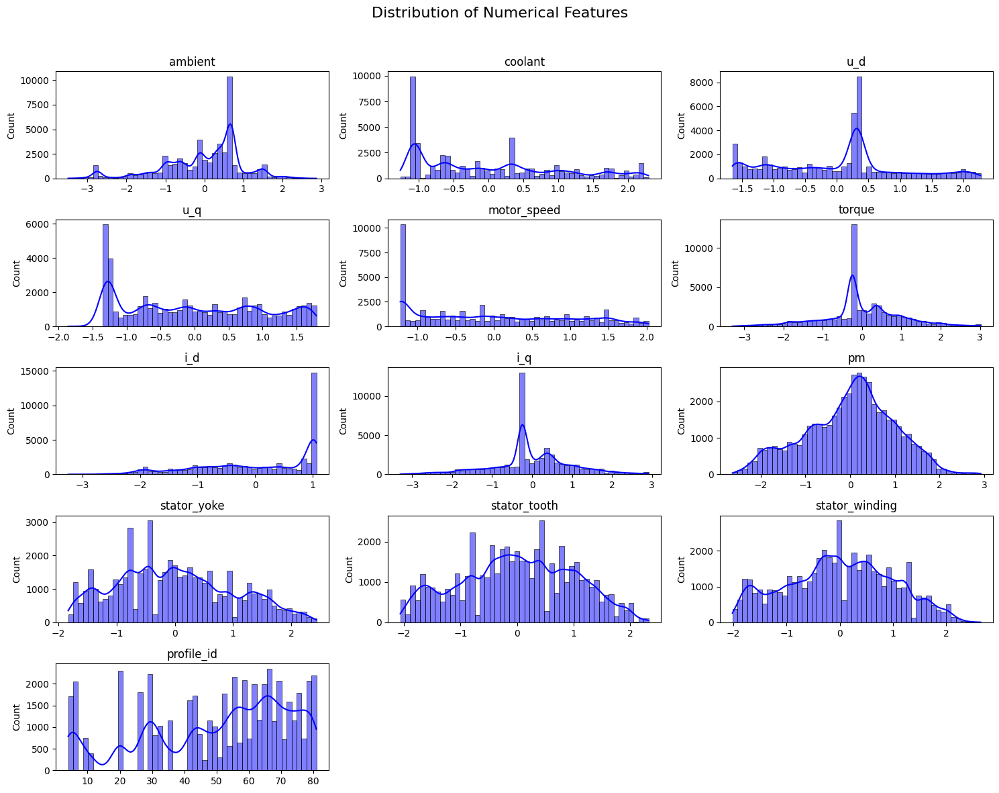

In [ ]:
fig, axes = plt.subplots(nrows=(len(numerical_columns) // 3) + 1, ncols=3, figsize=(15, 12))
fig.suptitle('Distribution of Numerical Features', fontsize=16)
axes = axes.flatten()

for i, col in enumerate(numerical_columns):
    sns.histplot(sampled_data[col], bins=50, kde=True, ax=axes[i], color='blue')
    axes[i].set_title(col)
    axes[i].set_xlabel('')

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

## Correlation Heatmap

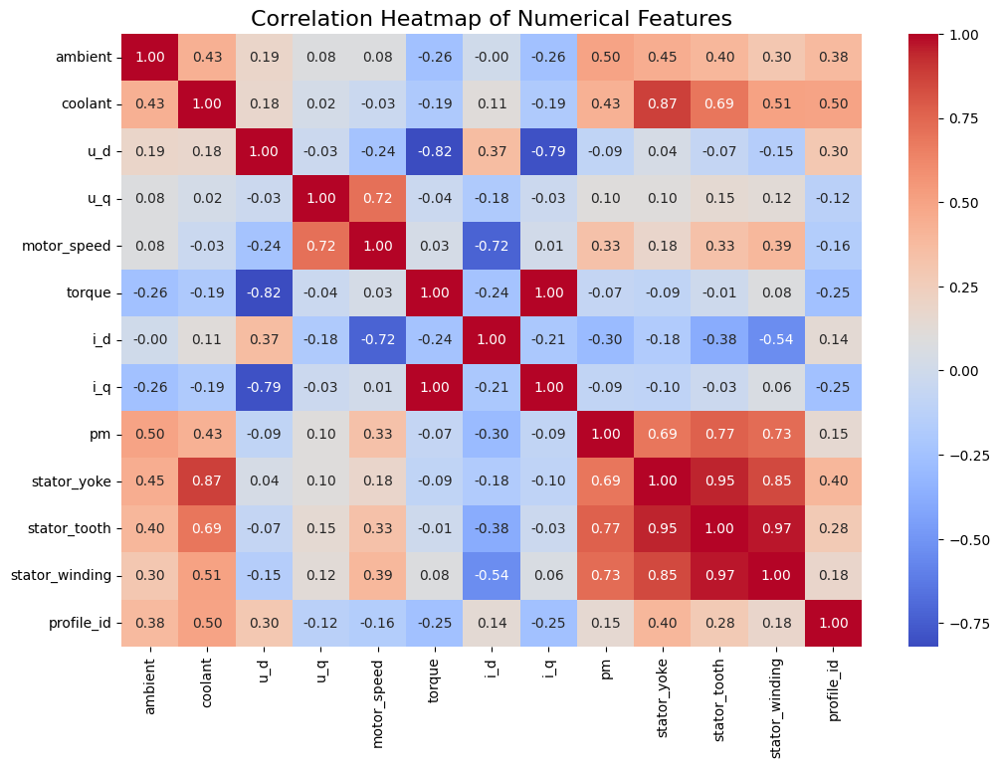

In [ ]:
plt.figure(figsize=(12, 8))
correlation_matrix = sampled_data[numerical_columns].corr()

sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Heatmap of Numerical Features", fontsize=16)
plt.show()

## Outlier Detection and Visualization

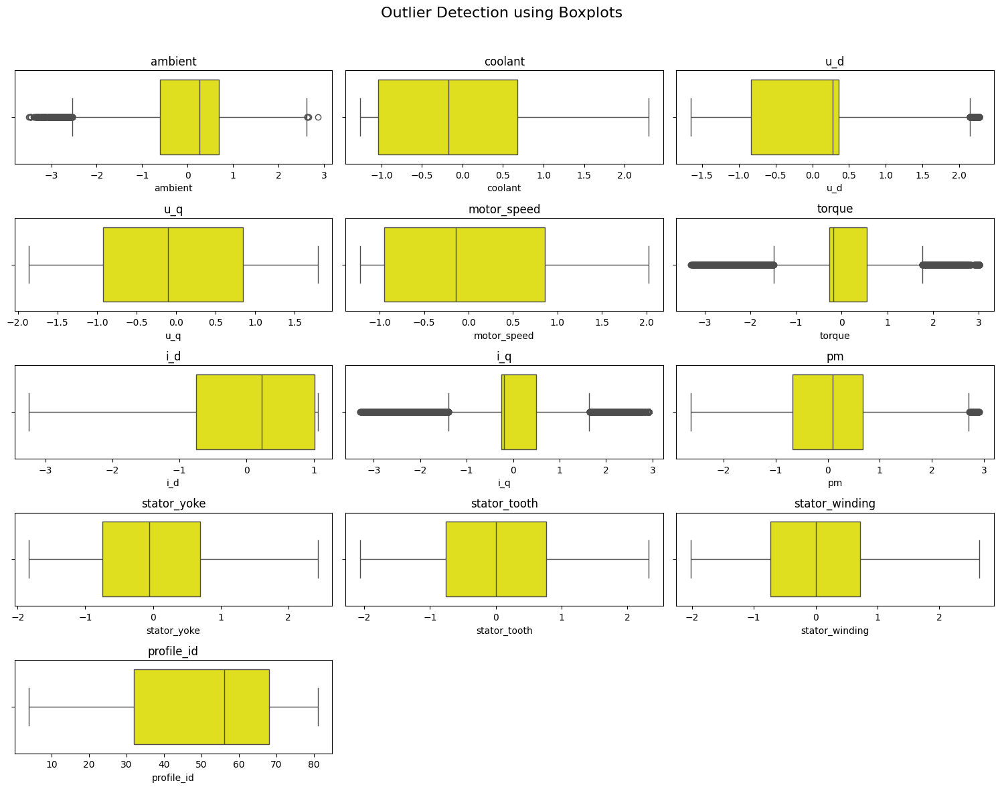

In [ ]:
# Boxplots for each numerical feature
fig, axes = plt.subplots(nrows=(len(numerical_columns) // 3) + 1, ncols=3, figsize=(15, 12))
fig.suptitle('Outlier Detection using Boxplots', fontsize=16)
axes = axes.flatten()

for i, col in enumerate(numerical_columns):
    sns.boxplot(x=sampled_data[col], ax=axes[i], color='yellow')
    axes[i].set_title(col)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


## Removing Outliers Using IQR

In [6]:
import pandas as pd

removed_outliers = {}

# Create a copy to avoid modifying the original dataset
cleaned_data = data.copy()

for col in numerical_columns:
    Q1 = cleaned_data[col].quantile(0.25)
    Q3 = cleaned_data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Identify outliers before modifying cleaned_data
    outliers = cleaned_data[(cleaned_data[col] < lower_bound) | (cleaned_data[col] > upper_bound)]
    removed_outliers[col] = outliers  # Store outliers for reference

    # Remove outliers from the dataset
    cleaned_data = cleaned_data[(cleaned_data[col] >= lower_bound) & (cleaned_data[col] <= upper_bound)]

    print(f"Column: {col}, Removed Outliers: {len(outliers)}")

# Printing removed outliers for each column
for col, outliers_df in removed_outliers.items():
    print(f"\nRemoved Outliers for {col}:")
    print(outliers_df)

print("Outliers have been removed from the dataset.")


Column: ambient, Removed Outliers: 38492
Column: coolant, Removed Outliers: 0
Column: u_d, Removed Outliers: 17035
Column: u_q, Removed Outliers: 0
Column: motor_speed, Removed Outliers: 0
Column: torque, Removed Outliers: 106298
Column: i_d, Removed Outliers: 76
Column: i_q, Removed Outliers: 26344
Column: pm, Removed Outliers: 1780
Column: stator_yoke, Removed Outliers: 0
Column: stator_tooth, Removed Outliers: 0
Column: stator_winding, Removed Outliers: 0
Column: profile_id, Removed Outliers: 0

Removed Outliers for ambient:
         ambient   coolant       u_d       u_q  motor_speed    torque  \
36414  -3.698899 -1.288667 -1.126325  0.746681     1.483029  0.350814   
36415  -2.890745 -1.233934 -1.128157  0.746986     1.483026  0.350116   
51062   2.628669  1.012596 -1.167476  0.707446     1.483026  0.341965   
51063   2.677169  1.012875 -1.166438  0.710380     1.483027  0.342024   
51064   2.710575  1.013156 -1.164715  0.710822     1.483030  0.342076   
...          ...       ...  

## Pairplot for Feature Relationships

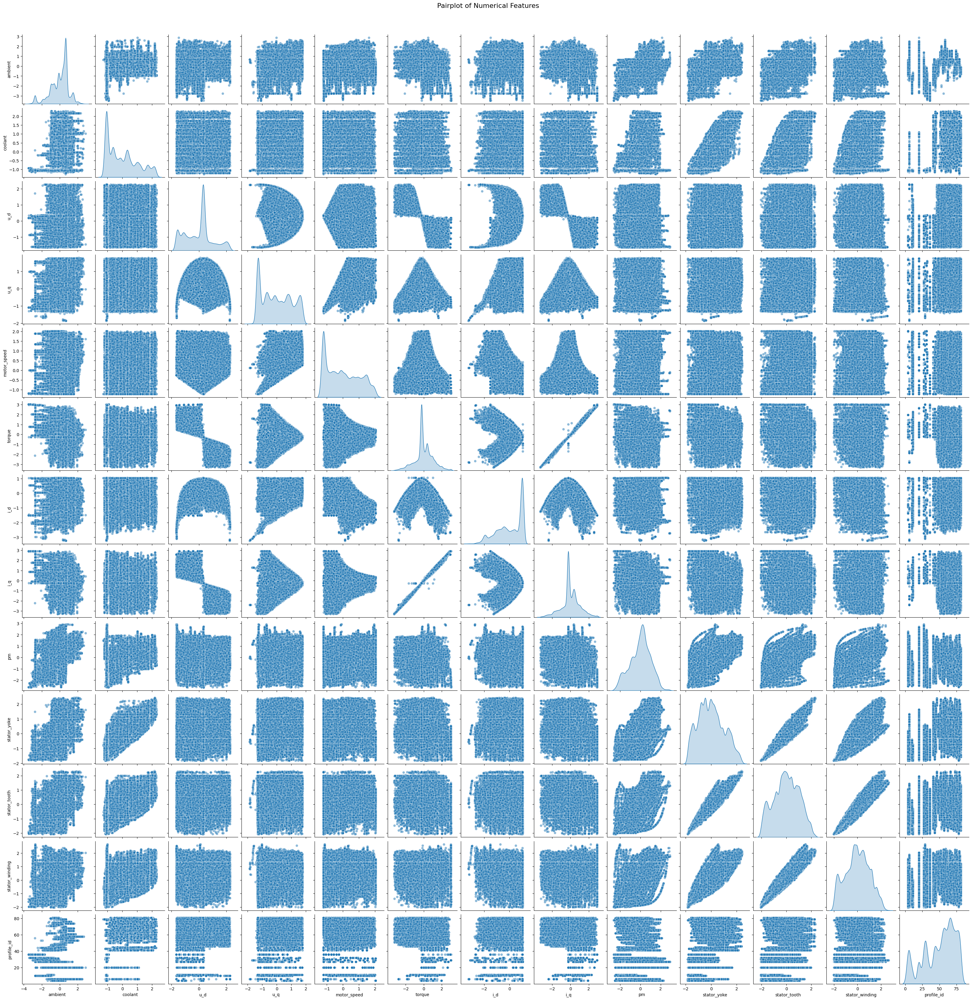

In [ ]:
sns.pairplot(sampled_data[numerical_columns], diag_kind='kde', plot_kws={'alpha': 0.5})
plt.suptitle('Pairplot of Numerical Features', y=1.02, fontsize=16)
plt.show()


## Violin Plots for Distribution Comparison

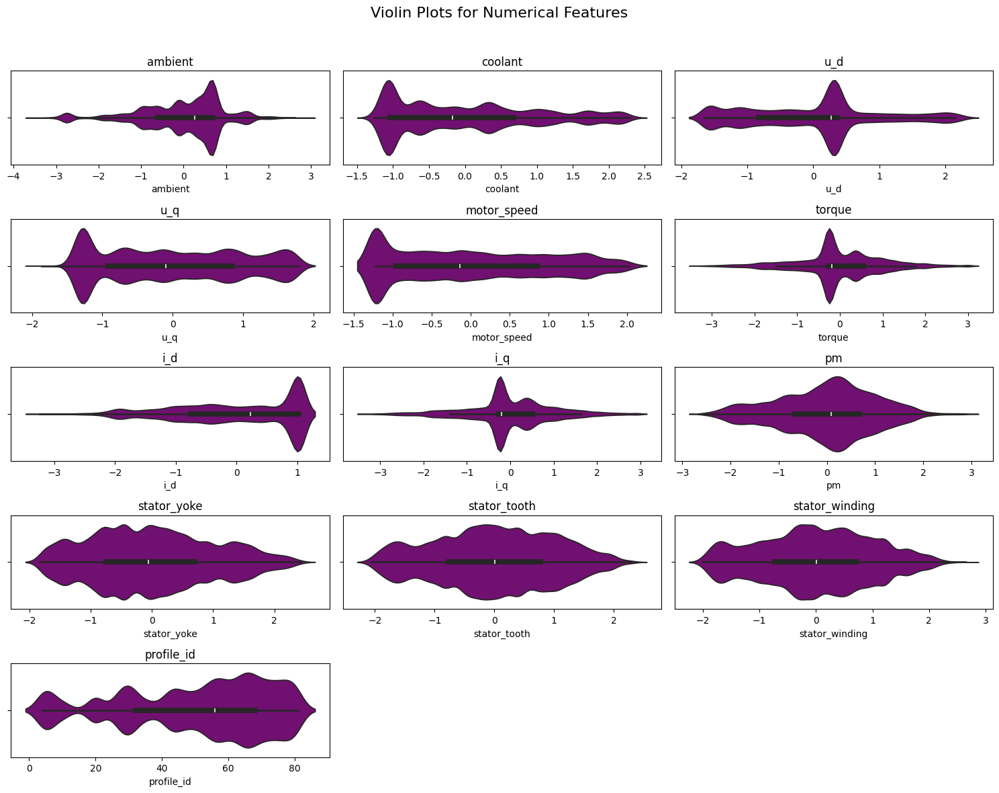

In [ ]:
fig, axes = plt.subplots(nrows=(len(numerical_columns) // 3) + 1, ncols=3, figsize=(15, 12))
fig.suptitle('Violin Plots for Numerical Features', fontsize=16)
axes = axes.flatten()

for i, col in enumerate(numerical_columns):
    sns.violinplot(x=sampled_data[col], ax=axes[i], color='purple')
    axes[i].set_title(col)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

## Scatterplot

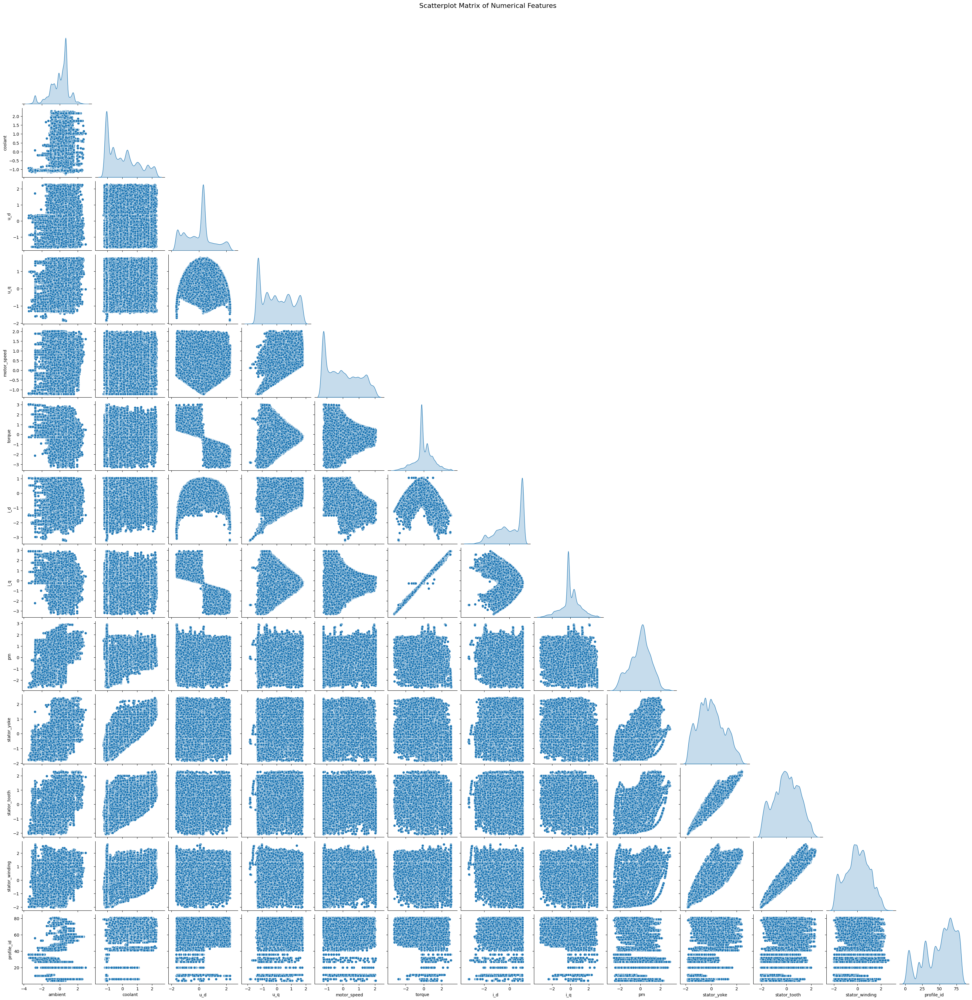

In [ ]:
sns.pairplot(sampled_data, diag_kind='kde', corner=True)
plt.suptitle('Scatterplot Matrix of Numerical Features', y=1.02, fontsize=16)
plt.show()


## KDE Plots

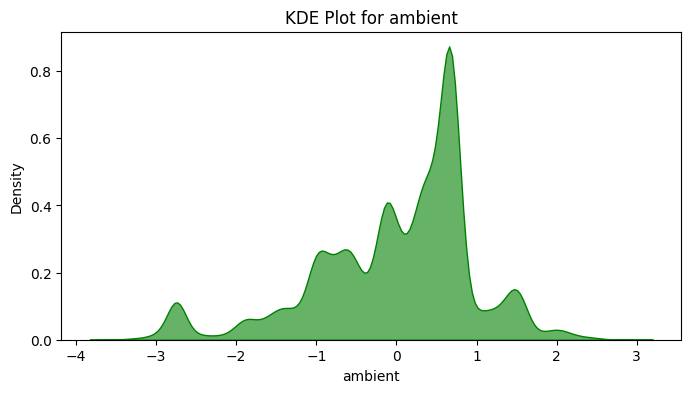

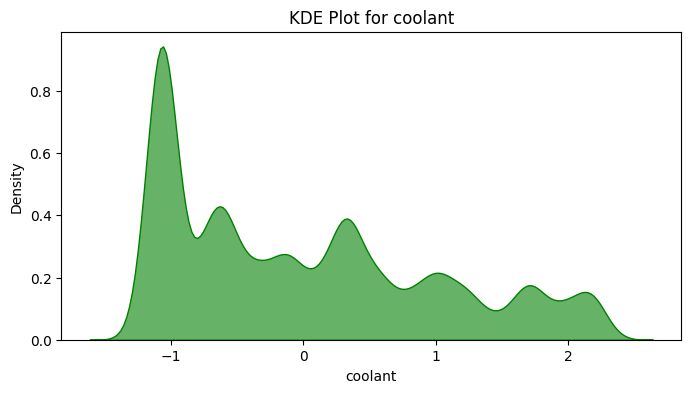

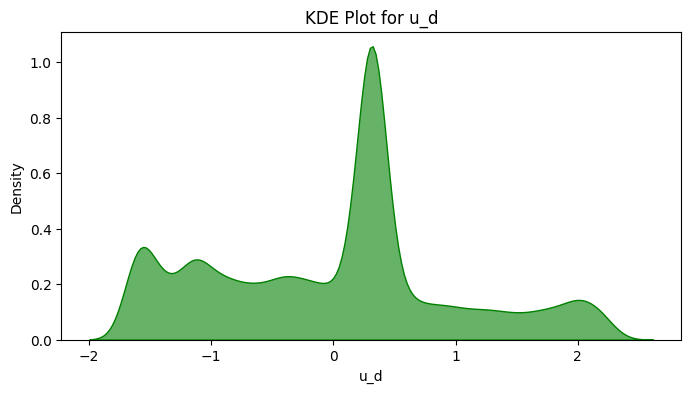

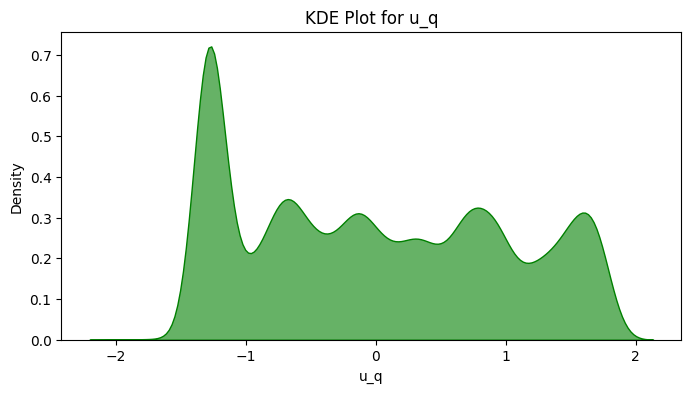

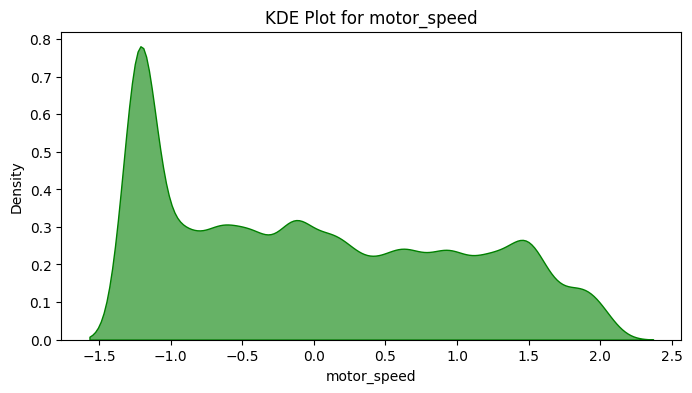

...

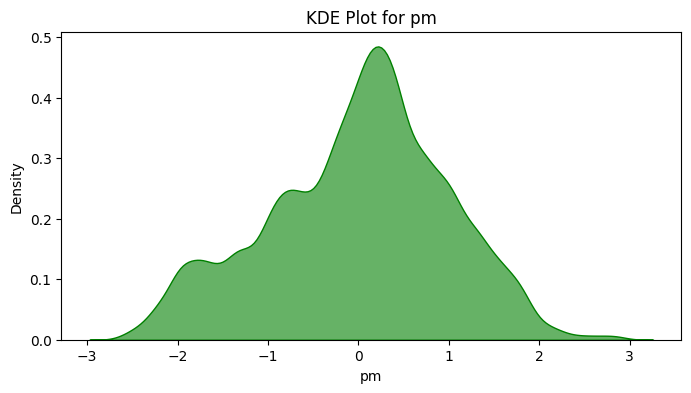

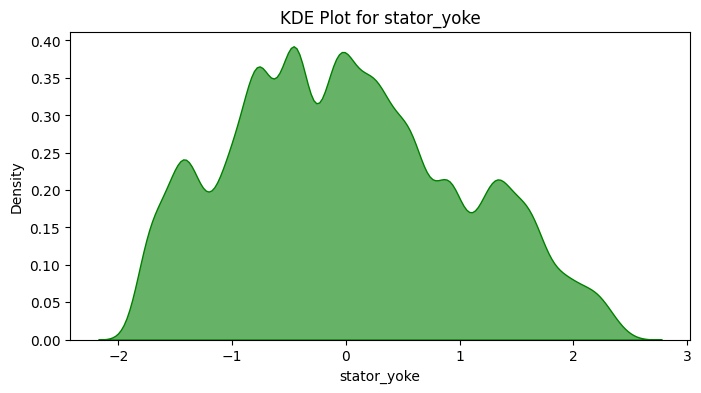

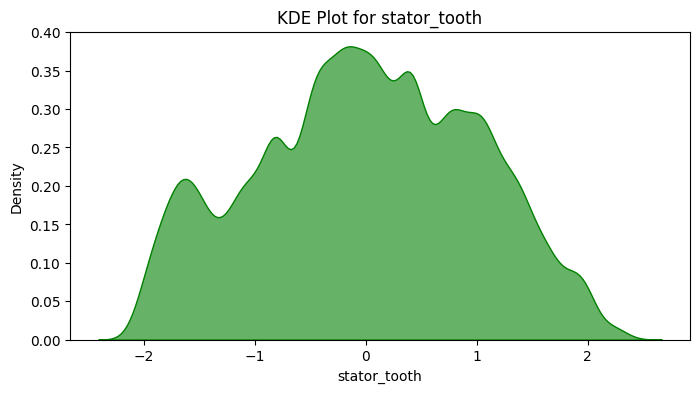

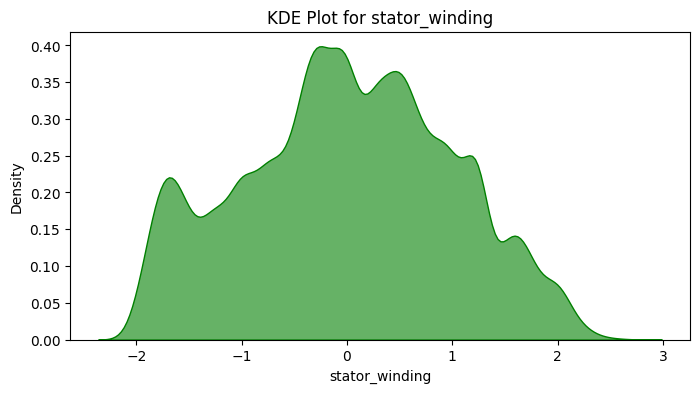

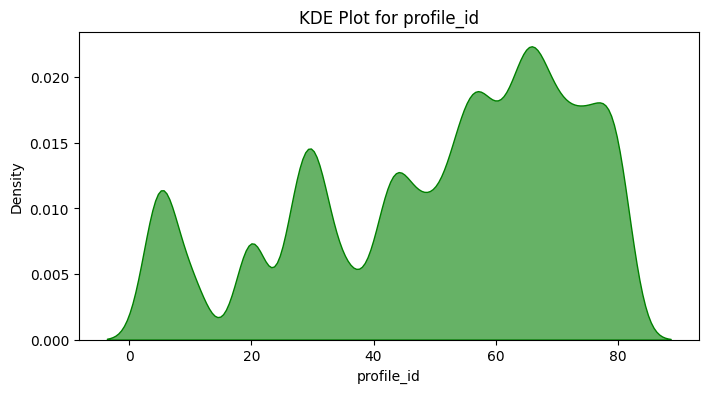

In [ ]:
for col in numerical_columns:
    plt.figure(figsize=(8, 4))
    sns.kdeplot(data=sampled_data, x=col, fill=True, color='green', alpha=0.6)
    plt.title(f'KDE Plot for {col}')
    plt.xlabel(col)
    plt.ylabel('Density')
    plt.show()


# **Findings:**
**Standardization Check**

* The mean of most columns is close to zero.

* The standard deviation is close to 1.

* This confirms that the data is standardized.




**Multicollinearity Check**



High correlations exist between:

      i_q and torque (0.996)

      stator_tooth and stator_yoke (0.95)

      stator_winding and stator_tooth (0.966)

These features carry redundant information and may need removal or transformation.



**Unnecessary Columns**


**profile_id**: Likely categorical and may not be useful in a regression model.

One of each highly correlated pair should be removed to reduce multicollinearity.


In [7]:
columns_to_drop = ["i_q", "stator_yoke", "stator_winding", "profile_id"]
data_cleaned = data.drop(columns=columns_to_drop)
numerical_columns=data_cleaned.select_dtypes(include=['float64','int64']).columns

In [ ]:
numerical_columns

Index(['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d',
       'pm', 'stator_tooth'],
      dtype='object')

## Summary of EDA

In [ ]:
print("\nEDA Summary:")
print("1. Data contains the following numerical columns:")
print(numerical_columns.tolist())
print("\n2. Correlation heatmap shows relationships between numerical variables.")
print("3. Outliers were detected,visualized using boxplots and removed using IQR Method.")
print("4. Pairplots,violin plots and scatter plots reveal feature distributions and relationships.")
print("5. KDE plots provide additional insights into feature distributions.")


EDA Summary:
1. Data contains the following numerical columns:
['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d', 'pm', 'stator_tooth']

2. Correlation heatmap shows relationships between numerical variables.
3. Outliers were detected,visualized using boxplots and removed using IQR Method.
4. Pairplots,violin plots and scatter plots reveal feature distributions and relationships.
5. KDE plots provide additional insights into feature distributions.


# **Model Building**

In [ ]:
data_cleaned

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,pm,stator_tooth
0,-0.752143,-1.118446,0.327935,-1.297858,-1.222428,-0.250182,1.029572,-2.522071,-2.066143
1,-0.771263,-1.117021,0.329665,-1.297686,-1.222429,-0.249133,1.029509,-2.522418,-2.064859
2,-0.782892,-1.116681,0.332771,-1.301822,-1.222428,-0.249431,1.029448,-2.522673,-2.064073
3,-0.780935,-1.116764,0.333700,-1.301852,-1.222430,-0.248636,1.032845,-2.521639,-2.063137
4,-0.774043,-1.116775,0.335206,-1.303118,-1.222429,-0.248701,1.031807,-2.521900,-2.062795
...,...,...,...,...,...,...,...,...,...
998065,-0.047497,0.341638,0.331475,-1.246114,-1.222428,-0.255640,1.029142,0.429853,0.836084
998066,-0.048839,0.320022,0.331701,-1.250655,-1.222437,-0.255640,1.029148,0.429751,0.834438
998067,-0.042350,0.307415,0.330946,-1.246852,-1.222430,-0.255640,1.029191,0.429439,0.833936
998068,-0.039433,0.302082,0.330987,-1.249505,-1.222432,-0.255640,1.029147,0.429558,0.830504


In [8]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Initialize StandardScaler
scaler = StandardScaler()


X = data_cleaned[['ambient', 'coolant', 'u_d', 'u_q', 'torque', 'i_d', 'pm', 'stator_tooth']]
y = data_cleaned['motor_speed']
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# **Cross Validation**

In [9]:
X_train_sample = X_train.sample(frac=0.1, random_state=42)  # 10% of X_train
y_train_sample = y_train.loc[X_train_sample.index]

In [ ]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
import lightgbm as lgb
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsRegressor
import numpy as np

def evaluate_model_with_cv(model_type, X, y, cv=5):
    if model_type == 'linear':
        model = LinearRegression()
    elif model_type == 'lasso':
        model = Lasso()
    elif model_type == 'ridge':
        model = Ridge()
    elif model_type == 'decision_tree':
        model = DecisionTreeRegressor()
    elif model_type == 'random_forest':
        model = RandomForestRegressor(n_jobs=-1, n_estimators=50, max_depth=10)
    elif model_type == 'lgbm':
        model = lgb.LGBMRegressor(verbose=-1)
    elif model_type == 'gradient_boosting':
        model = GradientBoostingRegressor()
    elif model_type == 'svr':
        model = SVR()
    elif model_type == 'mlp':
        model = MLPRegressor(max_iter=1000)  # MLP may require more iterations for convergence
    elif model_type == 'knn':
        model = KNeighborsRegressor()
    else:
        raise ValueError("Invalid model_type. Choose from: 'linear', 'lasso', 'ridge', 'decision_tree', 'random_forest', 'lgbm', 'gradient_boosting', 'svr', 'knn'")

    cv_scores = cross_val_score(model, X, y, cv=cv, scoring='r2')

    print(f'{model_type.capitalize()} CV Scores: {cv_scores}')
    print(f'Mean CV Score: {np.mean(cv_scores)}')

    return np.mean(cv_scores)


# Test the function with different models
evaluate_model_with_cv('linear', X_train_sample, y_train_sample, cv=5)
evaluate_model_with_cv('lasso', X_train_sample, y_train_sample, cv=5)
evaluate_model_with_cv('ridge', X_train_sample, y_train_sample, cv=5)
evaluate_model_with_cv('decision_tree', X_train_sample, y_train_sample, cv=5)
evaluate_model_with_cv('random_forest', X_train_sample, y_train_sample, cv=3)
evaluate_model_with_cv('lgbm', X_train_sample, y_train_sample, cv=3)
evaluate_model_with_cv('mlp', X_train_sample, y_train_sample, cv=3)
evaluate_model_with_cv('knn', X_train_sample, y_train_sample, cv=3)


/usr/local/lib/python3.11/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


Linear CV Scores: [0.9172084  0.91826759 0.91991528 0.91557628 0.91557362]
Mean CV Score: 0.9173082323446795
Lasso CV Scores: [-3.64960564e-05 -4.40146858e-05 -2.43612272e-06 -1.10121579e-05
 -1.18294225e-04]
Mean CV Score: -4.2450649528325e-05
Ridge CV Scores: [0.91720822 0.91826766 0.91991528 0.91557644 0.91557358]
Mean CV Score: 0.917308235450459
Decision_tree CV Scores: [0.99857392 0.99882169 0.99898438 0.99898451 0.99882695]
Mean CV Score: 0.9988382907093392
Random_forest CV Scores: [0.99579142 0.99481733 0.99560399]
Mean CV Score: 0.9954042455448731
Lgbm CV Scores: [0.99924405 0.99889712 0.99914927]
Mean CV Score: 0.9990968126006319
Mlp CV Scores: [0.99880458 0.99879666 0.99893841]
Mean CV Score: 0.9988465481688533
Knn CV Scores: [0.99428677 0.99412807 0.99423766]
Mean CV Score: 0.9942175011851818


0.9942175011851818

# **Linear Regression**

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error
model = LinearRegression()

param_space = {'copy_X': [True,False],
               'fit_intercept': [True,False],
               'n_jobs': [1,5,10,15,None],
               'positive': [True,False]}

random_search = RandomizedSearchCV(model, param_space, n_iter=40, cv=5)
random_search.fit(X_train, y_train)

# Parameter which gives the best results
print(f"Best Hyperparameters: {random_search.best_params_}")

# Accuracy of the model after using best parameters
print(f"Best Score: {random_search.best_score_}")



#Evaluate the model with the best hyperparameters
best_lr = random_search.best_estimator_
y_pred_lr = best_lr.predict(X_test)

r2 = r2_score(y_test, y_pred_lr)
mae = mean_absolute_error(y_test, y_pred_lr)
mse = mean_squared_error(y_test, y_pred_lr)

# Print the results
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")

Best Hyperparameters: {'positive': False, 'n_jobs': 1, 'fit_intercept': True, 'copy_X': True}
Best Score: 0.917784968448584
R² Score: 0.9180255240953006
Mean Absolute Error: 0.2127508673126002
Mean Squared Error: 0.08214825278035429


# **Ridge Regression**

In [ ]:
from sklearn.linear_model import Ridge
ridge = Ridge()
ridge_param_dist = {
    'alpha': np.logspace(-3, 3, 7),  # Log scale for alpha
    'max_iter': [1000, 2000, 3000]
}

ridge_random_search = RandomizedSearchCV(ridge, ridge_param_dist, n_iter=10, cv=5, scoring='r2', random_state=42)
ridge_random_search.fit(X_train, y_train)

# Best parameters and score for Ridge
print("Best Ridge parameters:", ridge_random_search.best_params_)
print("Best Ridge R2:", ridge_random_search.best_score_)

#Evaluate the model with the best hyperparameters
best_ridge = random_search.best_estimator_
y_pred_ridge = best_ridge.predict(X_test)

r2 = r2_score(y_test, y_pred_ridge)
mae = mean_absolute_error(y_test, y_pred_ridge)
mse = mean_squared_error(y_test, y_pred_ridge)

# Print the results
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")


Best Ridge parameters: {'max_iter': 3000, 'alpha': 0.1}
Best Ridge R2: 0.9177849684489006
R² Score: 0.9180255240953006
Mean Absolute Error: 0.2127508673126002
Mean Squared Error: 0.08214825278035429


# **Lasso Regression**

In [ ]:
from sklearn.linear_model import Lasso
lasso = Lasso()
ridge_param_dist = {
    'alpha': np.logspace(-3, 3, 7),  # Log scale for alpha
    'max_iter': [1000, 2000, 3000]
}

lasso_random_search = RandomizedSearchCV(lasso, ridge_param_dist, n_iter=10, cv=5, scoring='r2', random_state=42)
lasso_random_search.fit(X_train, y_train)

# Best parameters and score for Ridge
print("Best lasso parameters:", lasso_random_search.best_params_)
print("Best lasso R2:", lasso_random_search.best_score_)

#Evaluate the model with the best hyperparameters
best_lasso = random_search.best_estimator_
y_pred_lasso = best_lasso.predict(X_test)

r2 = r2_score(y_test, y_pred_lasso)
mae = mean_absolute_error(y_test, y_pred_lasso)
mse = mean_squared_error(y_test, y_pred_lasso)

# Print the results
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")


Best lasso parameters: {'max_iter': 1000, 'alpha': 0.001}
Best lasso R2: 0.9177359286556456
R² Score: 0.9180255240953006
Mean Absolute Error: 0.2127508673126002
Mean Squared Error: 0.08214825278035429


# **Decision Tree**

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
# Assuming X_train and y_train are your full training dataset


# Define a parameter grid
param_grid = {
    'criterion': ['squared_error', 'friedman_mse'],
     'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
}

# Create a Decision Tree model
dt = DecisionTreeRegressor(random_state=42)

# Perform Randomized Search with 10 iterations on 10% of the data
random_search = RandomizedSearchCV(
    estimator=dt,
    param_distributions=param_grid,
    n_iter=10,  # Randomly evaluate 10 combinations of parameters
    cv=5,  # 5-fold cross-validation
    scoring='r2',
    random_state=42,
    n_jobs=-1
)

# Fit the model on the 10% sample
random_search.fit(X_train_sample, y_train_sample)

# Output the best parameters and score
print("Best parameters: ", random_search.best_params_)
print("Best cross-validation accuracy: ", random_search.best_score_)

# Get the best model
best_model = random_search.best_estimator_


#Evaluate the model with the best hyperparameters
best_dt = random_search.best_estimator_
y_pred_dt = best_dt.predict(X_test)

r2 = r2_score(y_test, y_pred_dt)
mae = mean_absolute_error(y_test, y_pred_dt)
mse = mean_squared_error(y_test, y_pred_dt)

# Print the results
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")

Best parameters:  {'min_samples_split': 5, 'min_samples_leaf': 4, 'max_depth': 30, 'criterion': 'squared_error'}
Best cross-validation accuracy:  0.9989455390070789
R² Score: 0.999071950216927
Mean Absolute Error: 0.012095633294166543
Mean Squared Error: 0.0009300171465721412


In [ ]:
from sklearn.tree import DecisionTreeRegressor
model = DecisionTreeRegressor(
    criterion='squared_error',
    max_depth=30,
    min_samples_split=5,
    min_samples_leaf=4,
    random_state=42
)
model.fit(X_train,y_train)

y_pred_decisiontree = model.predict(X_test)
r2 = r2_score(y_test, y_pred_decisiontree)
mae = mean_absolute_error(y_test, y_pred_decisiontree)
mse = mean_squared_error(y_test, y_pred_decisiontree)
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")

R² Score: 0.9996543336862594
Mean Absolute Error: 0.0066869670049601385
Mean Squared Error: 0.00034639908831891403


# **Random Forest regressor**

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV

# Initialize the model
rf = RandomForestRegressor()
param_grid = {
    'n_estimators': [200,500],
    'max_depth': [10, 20,30],
    'min_samples_split': [2, 5]
}

# Perform Randomized Search
random_search = RandomizedSearchCV(
    estimator=rf,
    param_distributions=param_grid,
    n_iter=5,  # Number of random combinations to test
    cv=3,  # 3-fold cross-validation
    scoring='r2',  # Scoring metric
    random_state=42,
    n_jobs=-1  # Use all available CPUs
)

# Fit the model
random_search.fit(X_train_sample, y_train_sample)

# Best parameters and score
print("Best parameters found:", random_search.best_params_)
print("Best cross-validation score:", random_search.best_score_)


/usr/local/lib/python3.11/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best parameters found: {'n_estimators': 200, 'min_samples_split': 2, 'max_depth': 30}
Best cross-validation score: 0.9994372462477816


In [12]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error
model_rf = RandomForestRegressor(n_estimators=200,max_depth=30,min_samples_split=2,n_jobs=-1)
model_rf.fit(X_train,y_train)
y_pred_rf = model_rf.predict(X_test)
r2 = r2_score(y_test, y_pred_rf)
mae = mean_absolute_error(y_test, y_pred_rf)
mse = mean_squared_error(y_test, y_pred_rf)
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")

R² Score: 0.9998356988154184
Mean Absolute Error: 0.003909497307531076
Mean Squared Error: 0.00016464948502761502


# **lightgbm**


In [ ]:
import lightgbm as lgb
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

# Define the model
model = lgb.LGBMRegressor()

# Define the parameter grid
param_dist = {
    'num_leaves': [50, 100, 150, 200],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [5, 10, 15, 20],
    'lambda_l1': [0.1, 0.5, 1.0]
}

# Set verbose=-1 inside the model to suppress logging
lgbm = lgb.LGBMRegressor(verbose=-1)

# Perform randomized search with cross-validation
random_search = RandomizedSearchCV(estimator=lgbm, param_distributions=param_dist, n_iter=20, cv=5,
                                   scoring='neg_root_mean_squared_error', n_jobs=-1)

# Fit model
random_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best Parameters:", random_search.best_params_)
print("Best RMSE:", -random_search.best_score_)


#Evaluate the model with the best hyperparameters
best_lbgm = random_search.best_estimator_
y_pred_lbgm = best_lbgm.predict(X_test)

r2 = r2_score(y_test, y_pred_lbgm)
mae = mean_absolute_error(y_test, y_pred_lbgm)
mse = mean_squared_error(y_test, y_pred_lbgm)

# Print the results
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")

Best Parameters: {'num_leaves': 200, 'max_depth': 15, 'learning_rate': 0.1, 'lambda_l1': 1.0}
Best RMSE: 0.017043297139734234
R² Score: 0.9997628885775379
Mean Absolute Error: 0.007137565866361852
Mean Squared Error: 0.0002376140726068108


# **multi-layer-perceptron-mlp**

In [ ]:
pip uninstall keras-tuner


In [ ]:
import tensorflow as tf
!pip install keras-tuner
import keras_tuner as kt

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# Define custom hypermodel class
class MyHyperModel(kt.HyperModel):
    def build(self, hp):
        model = Sequential()
        model.add(Dense(
            units=hp.Int('units_1', min_value=32, max_value=128, step=32),
            activation=hp.Choice('activation_1', ['relu', 'tanh', 'sigmoid']),
            input_shape=(X_train.shape[1],)
        ))
        model.add(Dense(
            units=hp.Int('units_2', min_value=16, max_value=64, step=16),
            activation=hp.Choice('activation_2', ['relu', 'tanh', 'sigmoid'])
        ))
        model.add(Dense(1))  # Regression output layer

        model.compile(
            optimizer=hp.Choice('optimizer', ['adam', 'sgd', 'rmsprop']),
            loss='mse',
            metrics=['mae', 'mse']
        )
        return model

# Instantiate HyperModel
hypermodel = MyHyperModel()

# Define tuner with Random Search
tuner = kt.RandomSearch(
    hypermodel,
    objective='val_mse',
    max_trials=2,
    executions_per_trial=1,
    directory='keras_tuner_dir',
    project_name='regression_tuning'
)

# Perform hyperparameter search
tuner.search(X_train, y_train, epochs=5, validation_data=(X_test, y_test), verbose=1)

# Get best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print("\nBest Hyperparameters Found:")
for key, value in best_hps.values.items():
    print(f"{key}: {value}")

# Train the best model
best_model = tuner.hypermodel.build(best_hps)
history = best_model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test), verbose=1)


Trial 2 Complete [00h 07m 42s]
val_mse: 0.0006632970180362463

Best val_mse So Far: 0.0005588446510955691
Total elapsed time: 00h 16m 30s

Best Hyperparameters Found:
units_1: 32
activation_1: tanh
units_2: 16
activation_2: sigmoid
optimizer: adam
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


24952/24952 ━━━━━━━━━━━━━━━━━━━━ 85s 3ms/step - loss: 0.0213 - mae: 0.0624 - mse: 0.0213 - val_loss: 7.9499e-04 - val_mae: 0.0131 - val_mse: 7.9499e-04
Epoch 2/10
24952/24952 ━━━━━━━━━━━━━━━━━━━━ 86s 3ms/step - loss: 0.0010 - mae: 0.0138 - mse: 0.0010 - val_loss: 6.6711e-04 - val_mae: 0.0113 - val_mse: 6.6711e-04
Epoch 3/10
24952/24952 ━━━━━━━━━━━━━━━━━━━━ 75s 3ms/step - loss: 9.3744e-04 - mae: 0.0127 - mse: 9.3744e-04 - val_loss: 7.4412e-04 - val_mae: 0.0143 - val_mse: 7.4412e-04
Epoch 4/10
24952/24952 ━━━━━━━━━━━━━━━━━━━━ 81s 3ms/step - loss: 8.2922e-04 - mae: 0.0119 - mse: 8.2922e-04 - val_loss: 5.8615e-04 - val_mae: 0.0105 - val_mse: 5.8615e-04
Epoch 5/10
24952/24952 ━━━━━━━━━━━━━━━━━━━━ 75s 3ms/step - loss: 8.0194e-04 - mae: 0.0116 - mse: 8.0194e-04 - val_loss: 5.6270e-04 - val_mae: 0.0102 - val_mse: 5.6270e-04
Epoch 6/10
24952/24952 ━━━━━━━━━━━━━━━━━━━━ 77s 3ms/step - loss: 7.2949e-04 - mae: 0.0111 - mse: 7.2949e-04 - val_loss: 4.9777e-04 - val_mae: 0.0104 - val_mse: 4.9777e-04
E

In [ ]:
y_pred_nn = best_model.predict(X_test)
r2 = r2_score(y_test, y_pred_nn)
mae = mean_absolute_error(y_test, y_pred_nn)
mse = mean_squared_error(y_test, y_pred_nn)

# Print the results
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")

6238/6238 ━━━━━━━━━━━━━━━━━━━━ 9s 1ms/step
R² Score: 0.9996142099711869
Mean Absolute Error: 0.009193499349698276
Mean Squared Error: 0.00038660786125578405


# **KNN**

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

# Create the KNN regressor model
knn = KNeighborsRegressor()

# Define the hyperparameters to search over
param_dist = {
    'n_neighbors': [5,10,15],
    'weights': ['uniform', 'distance'],           # Weights for neighbors
    'algorithm': ['auto', 'ball_tree'],  # Nearest neighbors algorithm
    'leaf_size': [10,20],
    'p': [1, 2]                                   # Power parameter for the Minkowski distance (1 = Manhattan, 2 = Euclidean)
}

# Create the RandomizedSearchCV object
random_search = RandomizedSearchCV(knn, param_distributions=param_dist,
                                   n_iter=10, cv=3, n_jobs=-1, random_state=42)

# Fit the random search to the training data
random_search.fit(X_train, y_train)

# Get the best hyperparameters
best_params = random_search.best_params_
print(f'Best hyperparameters: {best_params}')

# Evaluate the model with the best hyperparameters
best_knn = random_search.best_estimator_
y_pred = best_knn.predict(X_test)


r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

# Print the results
print(f"R² Score: {r2}")
print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")

Best hyperparameters: {'weights': 'distance', 'p': 2, 'n_neighbors': 5, 'leaf_size': 10, 'algorithm': 'ball_tree'}
R² Score: 0.9992963121767163
Mean Absolute Error: 0.010069763884993818
Mean Squared Error: 0.0007051795640971162


Model Name | Accuracy
-------------------|------------------
Linear Regression | 91.80%
Lasso | 91.80%
Ridge Regression | 91.80%
Decision Tree | 99.96%
Random Forest Regression | 99.98%
Lightgbm | 99.97%
ANN Regression | 99.96%
KNN | 99.92%

found that Random Forest is the best model for this dataset.So we are moving forward with Randomset.

In [14]:
# Take user input and predict motor speed
user_input = {}
for feature in ['ambient', 'coolant', 'u_d', 'u_q', 'torque', 'i_d', 'pm', 'stator_tooth']:
    user_input[feature] = float(input(f"Enter value for {feature}: "))

# Convert input to DataFrame and scale
user_df = pd.DataFrame([user_input])
user_scaled = scaler.transform(user_df)

# Predict motor speed
predicted_speed = model_rf.predict(user_scaled)
print(f"Predicted Motor Speed: {predicted_speed[0]}")

Enter value for ambient: -0.75214297
Enter value for coolant: -1.1184461
Enter value for u_d: 0.3279352
Enter value for u_q: -1.2978575
Enter value for torque: -0.2501821
Enter value for i_d: 1.0295724
Enter value for pm: -2.522071
Enter value for stator_tooth: -2.0661428
Predicted Motor Speed: -1.2224032822521274


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
